In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
tf.__version__

'2.6.0'

In [2]:
base_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')

87924736/87910968 [==============================] - 11s 0us/step


In [3]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [4]:
len(base_model.layers)

311

In [5]:
names = ['mixed3', 'mixed5']

In [6]:
base_model.input

<KerasTensor: shape=(None, None, None, 3) dtype=float32 (created by layer 'input_1')>

In [7]:
layers = [base_model.get_layer(name).output for name in names]

In [8]:
layers

[<KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed3')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed5')>]

In [9]:
deep_dream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

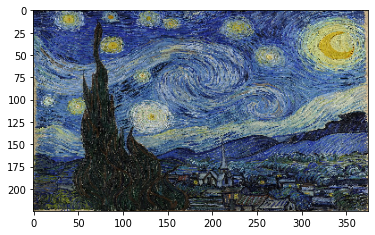

In [11]:
image = tf.keras.preprocessing.image.load_img('required/Images/StaryNight.jpg',
                                              target_size=(225, 375))

plt.imshow(image)

In [12]:
list(image.getdata())

[(6, 10, 11),
 (30, 33, 66),
 (35, 46, 66),
 (39, 46, 65),
 (46, 49, 68),
 (23, 27, 39),
 (13, 15, 38),
 (57, 61, 86),
 (85, 88, 97),
 (147, 147, 139),
 (138, 139, 123),
 (112, 116, 117),
 (18, 21, 52),
 (23, 28, 60),
 (85, 96, 116),
 (83, 92, 121),
 (148, 152, 155),
 (29, 32, 63),
 (57, 63, 99),
 (12, 20, 39),
 (34, 39, 69),
 (23, 30, 56),
 (4, 12, 48),
 (25, 32, 74),
 (48, 50, 98),
 (134, 133, 173),
 (127, 132, 152),
 (126, 133, 161),
 (138, 151, 168),
 (64, 76, 126),
 (67, 83, 119),
 (61, 75, 112),
 (73, 90, 134),
 (86, 118, 143),
 (55, 81, 80),
 (136, 155, 135),
 (51, 65, 74),
 (152, 169, 195),
 (156, 176, 211),
 (56, 79, 129),
 (94, 116, 165),
 (70, 94, 120),
 (160, 173, 189),
 (142, 156, 185),
 (92, 118, 135),
 (50, 74, 118),
 (107, 132, 162),
 (101, 122, 153),
 (27, 36, 67),
 (34, 44, 79),
 (97, 114, 140),
 (21, 41, 66),
 (51, 60, 101),
 (50, 56, 104),
 (34, 39, 68),
 (22, 24, 45),
 (3, 3, 29),
 (4, 7, 22),
 (28, 37, 34),
 (19, 27, 29),
 (19, 25, 41),
 (43, 49, 75),
 (93, 104, 1

In [13]:
image = tf.keras.preprocessing.image.img_to_array(image)

In [14]:
type(image)

numpy.ndarray

In [15]:
image.shape

(225, 375, 3)

In [16]:
image.min(), image.max()

(0.0, 255.0)

In [17]:
image = tf.keras.applications.inception_v3.preprocess_input(image)

In [18]:
image.min(), image.max()

(-1.0, 1.0)

In [19]:
image_batch = tf.expand_dims(image, axis = 0)

In [20]:
image_batch.shape

TensorShape([1, 225, 375, 3])

In [21]:
activations = deep_dream_model.predict(image_batch)

In [22]:
deep_dream_model.outputs

[<KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed3')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed5')>]

In [23]:
len(activations)

2

In [24]:
activations[1]

array([[[[0.        , 0.        , 1.4951732 , ..., 0.        ,
          0.        , 0.        ],
         [2.1904202 , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [1.2252231 , 0.        , 0.39387968, ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.27098605, ..., 1.2395109 ,
          0.        , 0.        ],
         [0.        , 0.1509574 , 0.64265454, ..., 0.91670835,
          0.        , 0.        ],
         [0.        , 0.        , 1.6167862 , ..., 0.59690857,
          0.        , 0.        ]],

        [[0.        , 0.        , 0.        , ..., 0.05806565,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.67040044, 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 1.2452439 ,
          0.        , 0.0

In [25]:
activations[0].shape, activations[1].shape

((1, 12, 21, 768), (1, 12, 21, 768))

In [27]:
def calculate_loss(image, network):
    image_batch = tf.expand_dims(image, axis = 0)
    activations = network(image_batch)

    losses = []
    for act in activations:
        loss = tf.math.reduce_mean(act)
        losses.append(loss)

    #print(losses)
    #print(np.shape(losses))
    #print(tf.reduce_sum(losses))

    return tf.reduce_sum(losses)

In [28]:
loss = calculate_loss(image, deep_dream_model)
loss

<tf.Tensor: shape=(), dtype=float32, numpy=0.6180765>

In [29]:
# Compare the activations with the pixels
# Emphasize parts of the image
# Change the pixels of the input image

@tf.function
def deep_dream(network, image, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(image)
        loss = calculate_loss(image, network)

    gradients = tape.gradient(loss, image) # Derivate
    gradients /= tf.math.reduce_std(gradients)
    image = image + gradients * learning_rate
    image = tf.clip_by_value(image, -1, 1)

    return loss, image

def inverse_transform(image):
    image = 255 * (image + 1.0) / 2.0
    return tf.cast(image, tf.uint8)

def run_deep_dream(network, image, epochs, learning_rate):
    for epoch in range(epochs):
        loss, image = deep_dream(network, image, learning_rate)

        if epoch % 200 == 0:
            plt.figure(figsize=(12,12))
            plt.imshow(inverse_transform(image))
            plt.show()
            print('Epoch {}, loss {}'.format(epoch, loss))

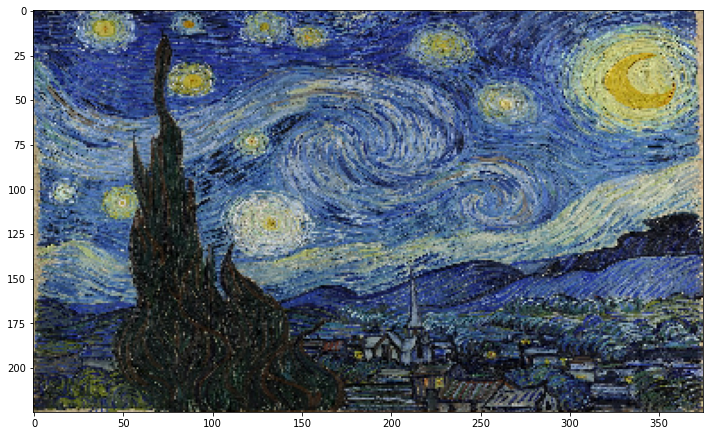

Epoch 0, loss 0.618076503276825


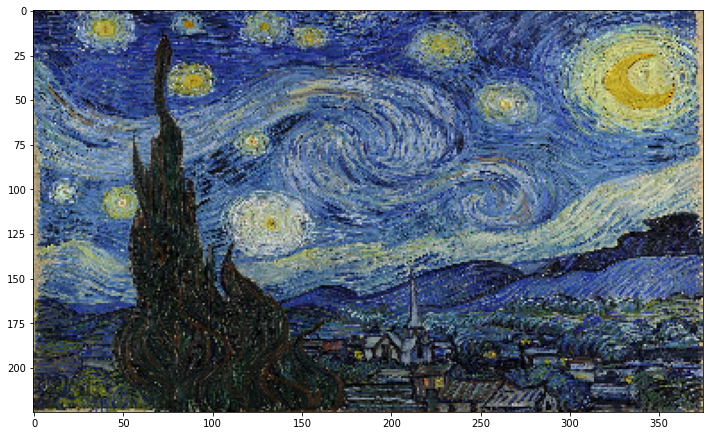

Epoch 200, loss 0.8647395372390747


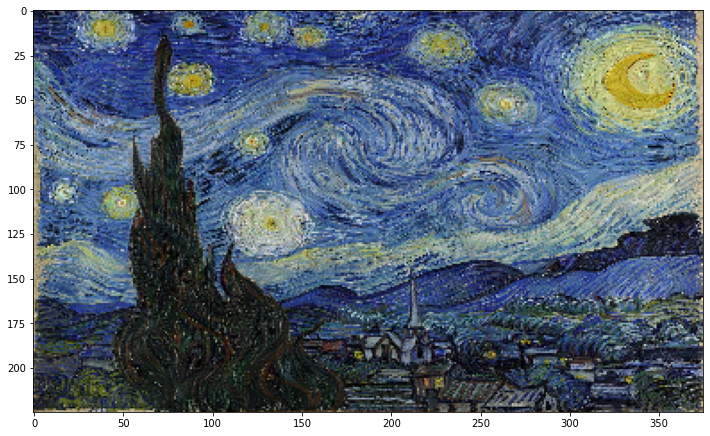

Epoch 400, loss 1.062436819076538


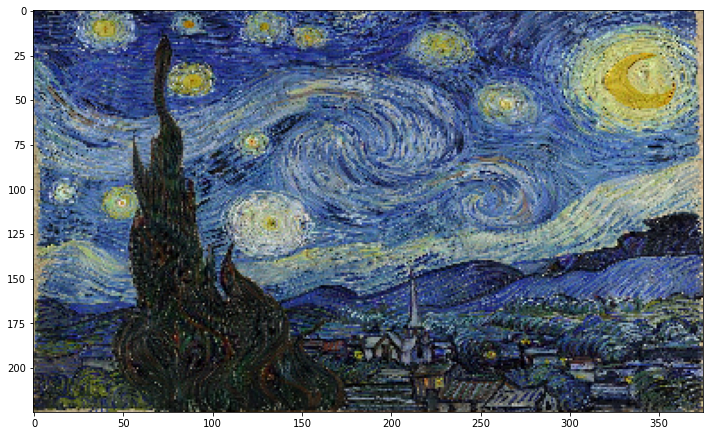

Epoch 600, loss 1.2185065746307373


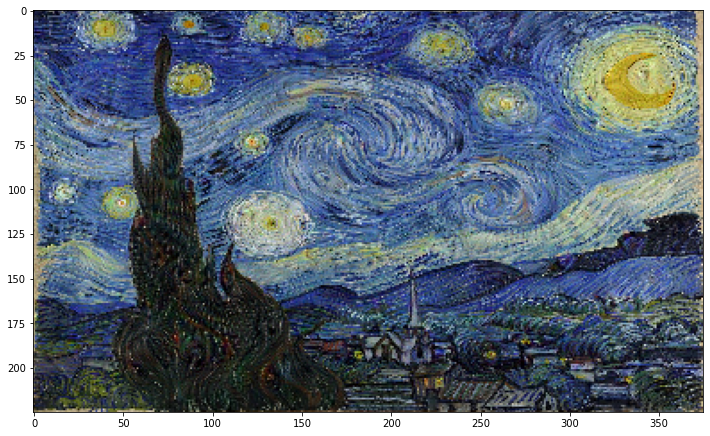

Epoch 800, loss 1.3446056842803955


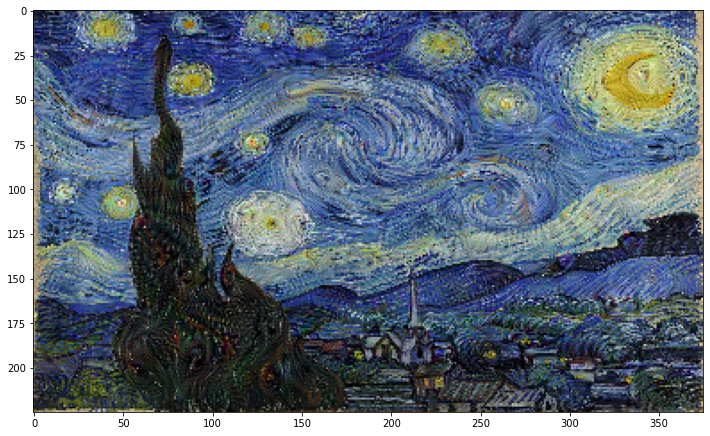

Epoch 1000, loss 1.4465683698654175


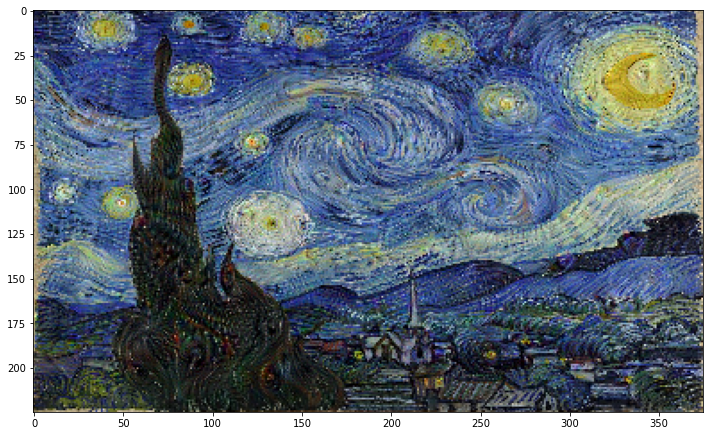

Epoch 1200, loss 1.5322102308273315


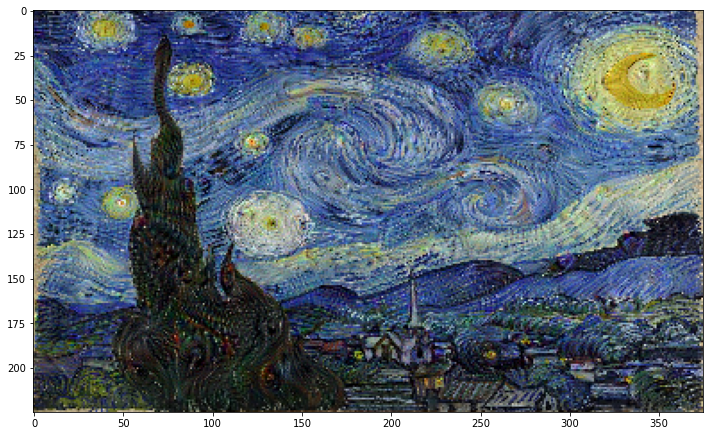

Epoch 1400, loss 1.6047015190124512


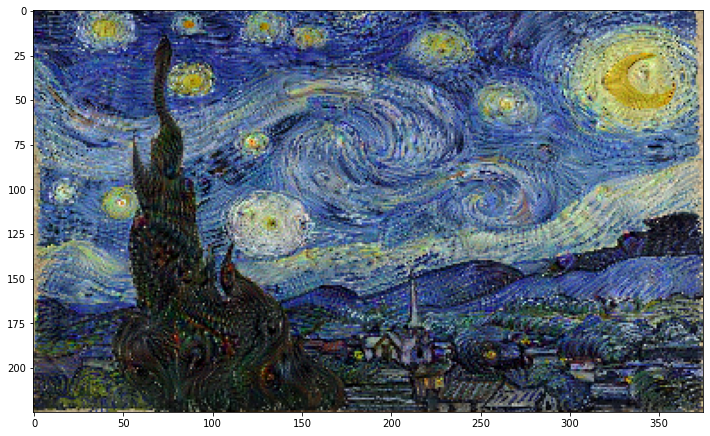

Epoch 1600, loss 1.6678833961486816


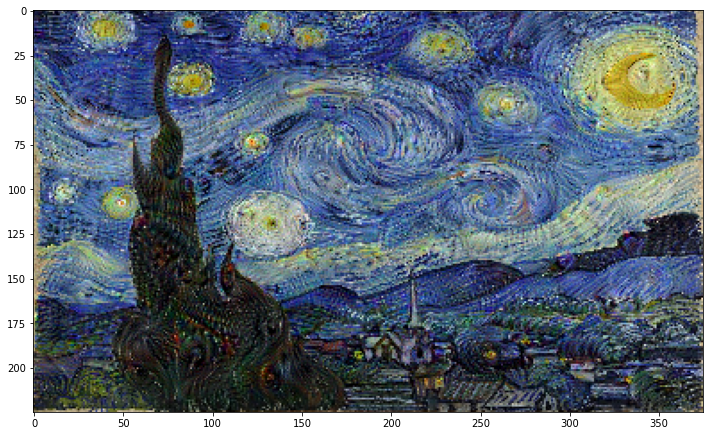

Epoch 1800, loss 1.7235952615737915


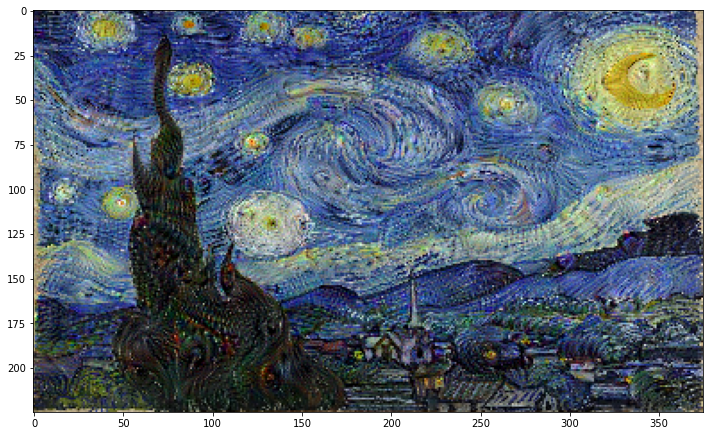

Epoch 2000, loss 1.773935317993164


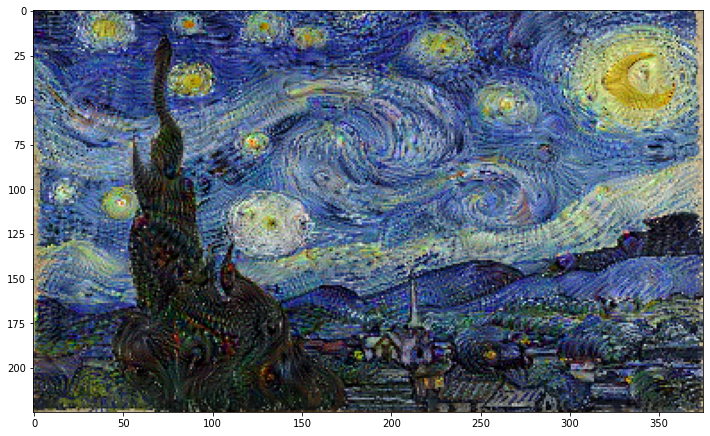

Epoch 2200, loss 1.8207354545593262


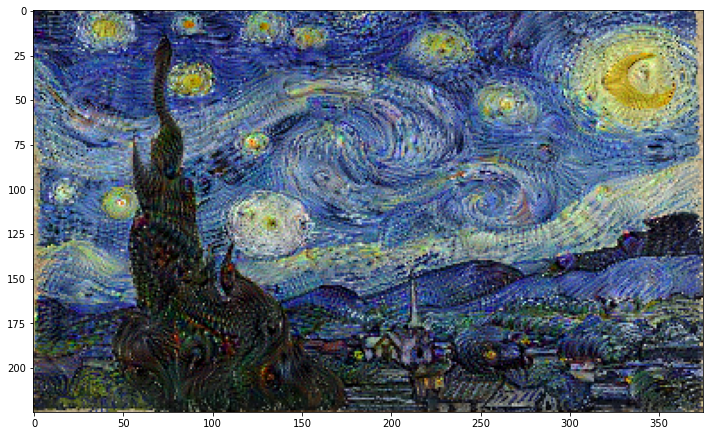

Epoch 2400, loss 1.8632168769836426


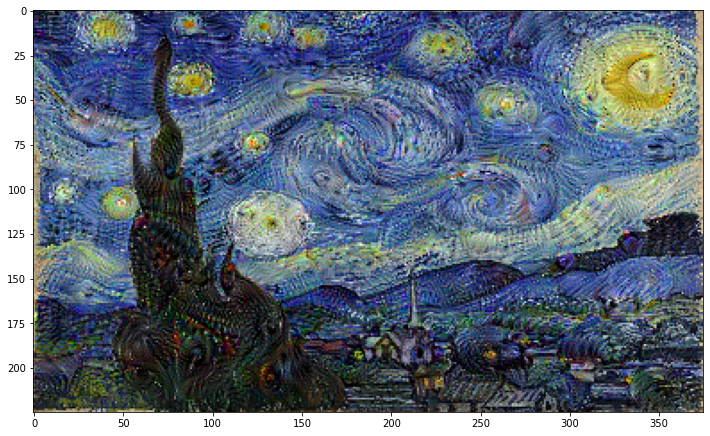

Epoch 2600, loss 1.90191650390625


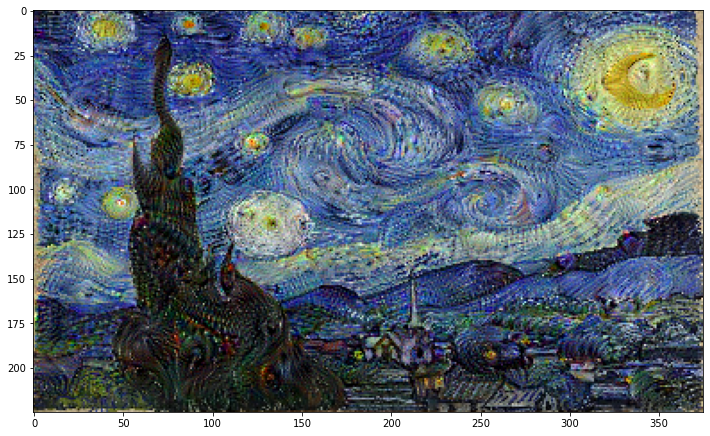

Epoch 2800, loss 1.9371626377105713


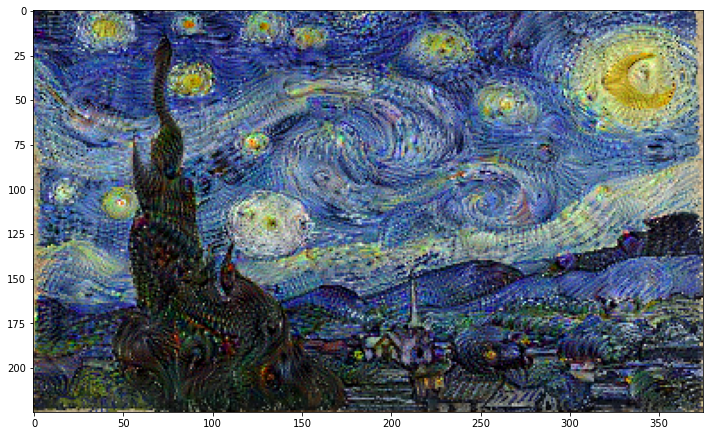

Epoch 3000, loss 1.9703004360198975


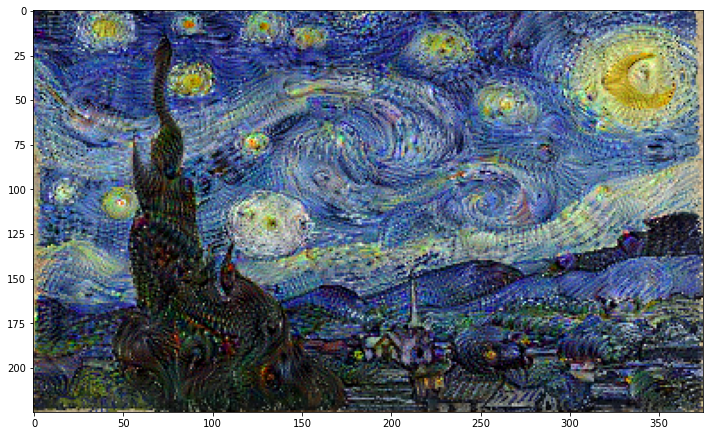

Epoch 3200, loss 2.000964403152466


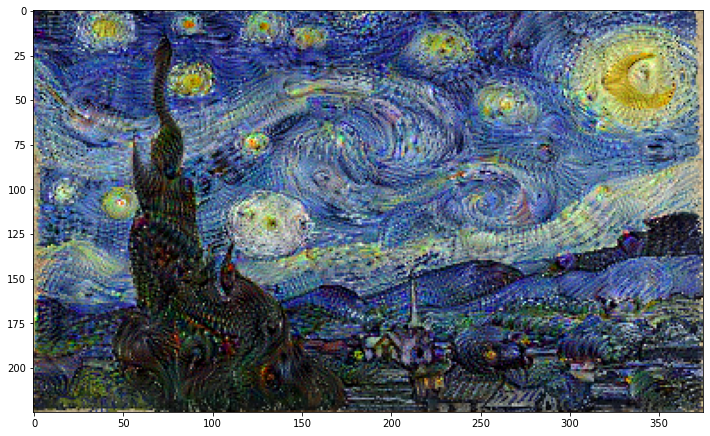

Epoch 3400, loss 2.029942512512207


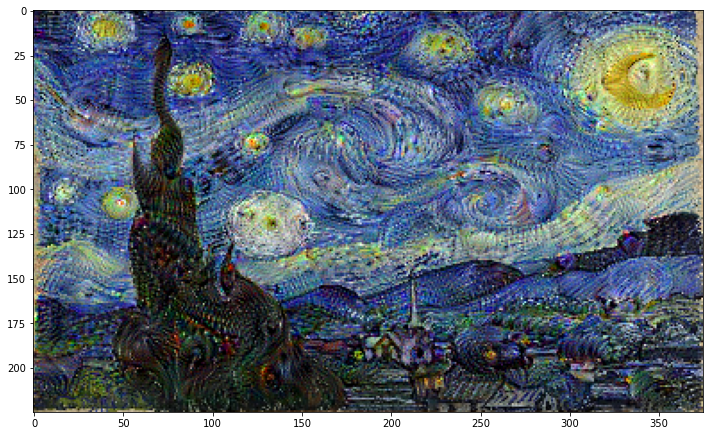

Epoch 3600, loss 2.057681083679199


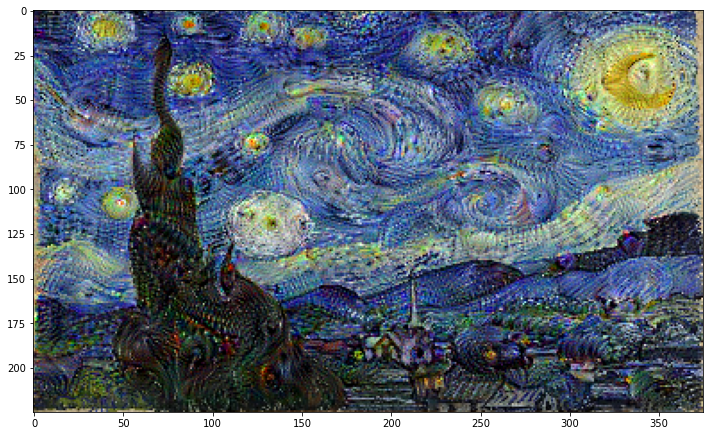

Epoch 3800, loss 2.083948850631714


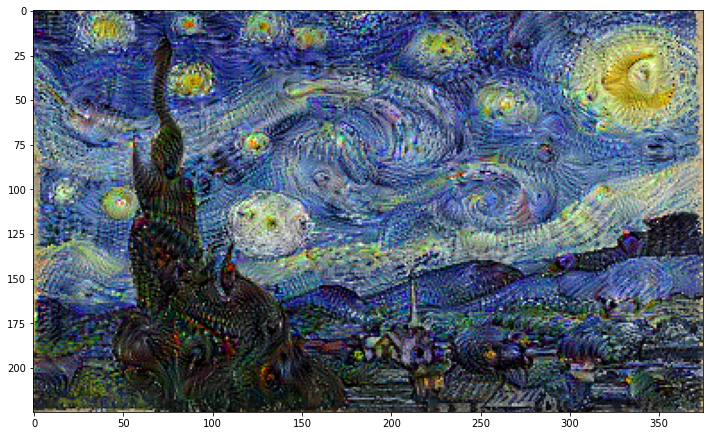

Epoch 4000, loss 2.108968496322632


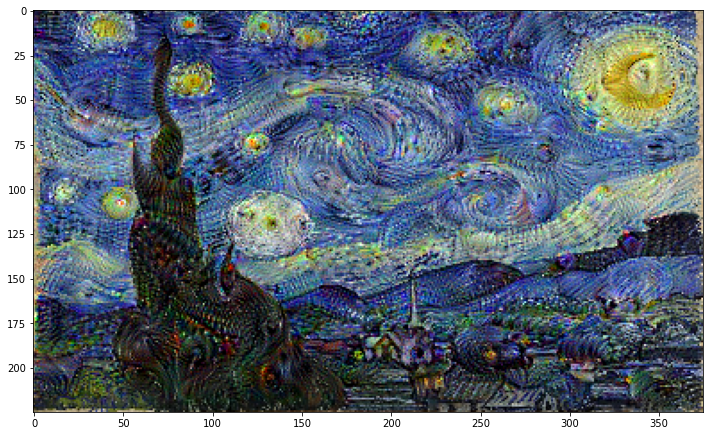

Epoch 4200, loss 2.132673740386963


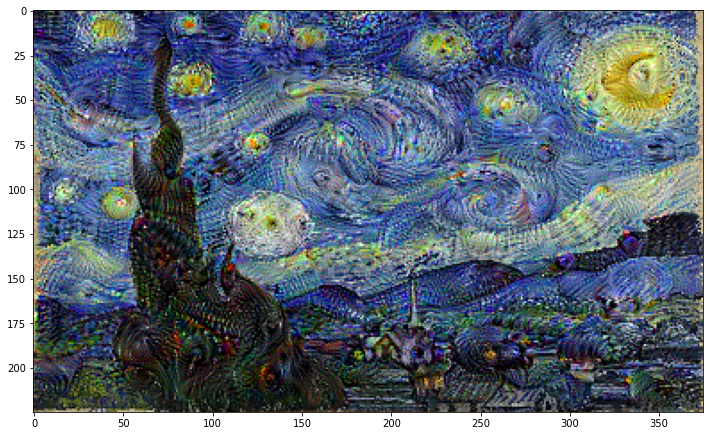

Epoch 4400, loss 2.1553406715393066


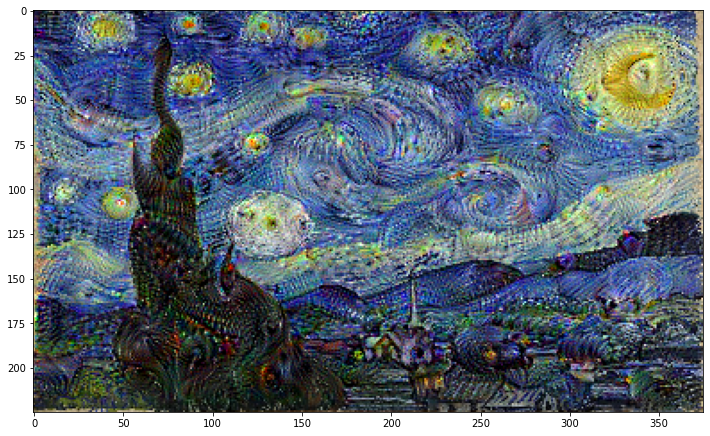

Epoch 4600, loss 2.176832437515259


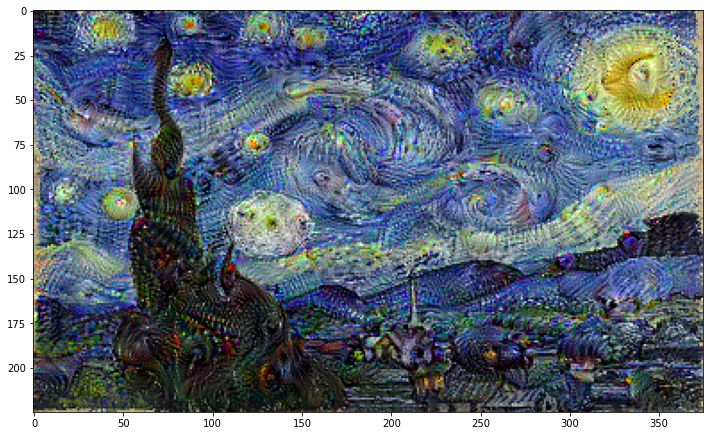

Epoch 4800, loss 2.1975483894348145


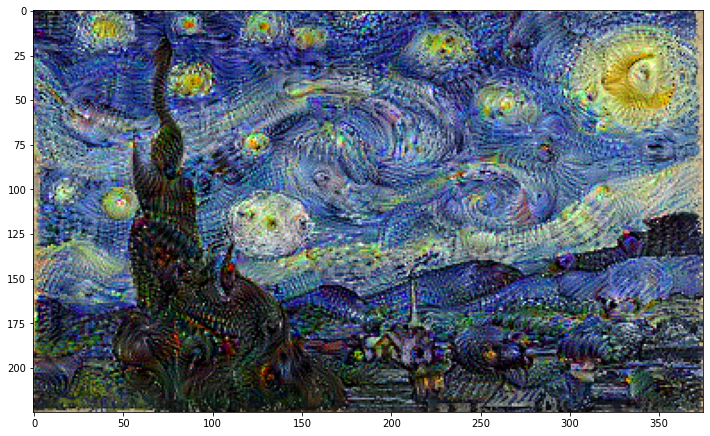

Epoch 5000, loss 2.2174220085144043


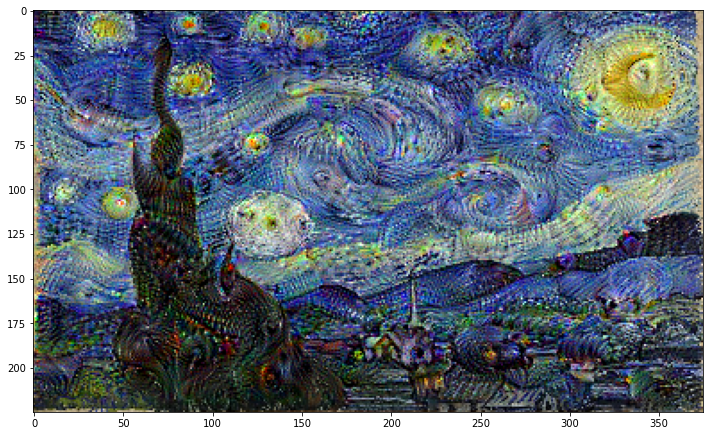

Epoch 5200, loss 2.2365517616271973


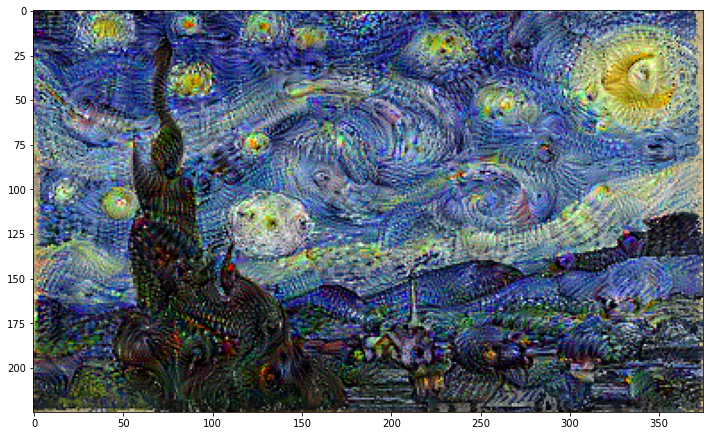

Epoch 5400, loss 2.2553036212921143


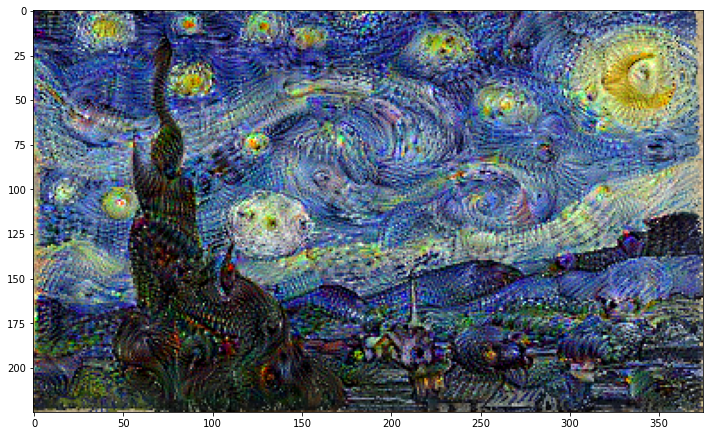

Epoch 5600, loss 2.2733795642852783


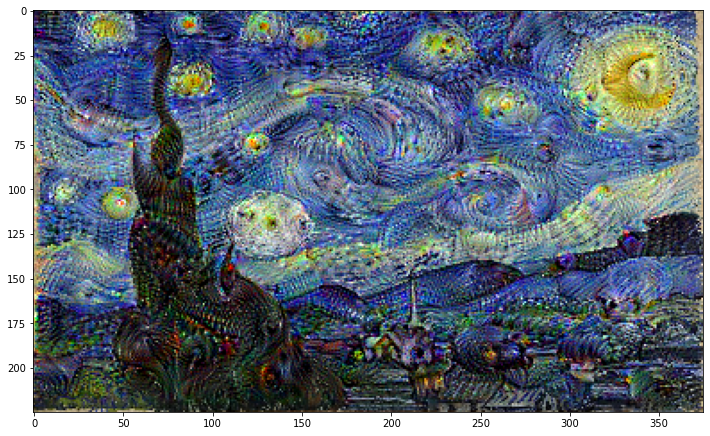

Epoch 5800, loss 2.290717363357544


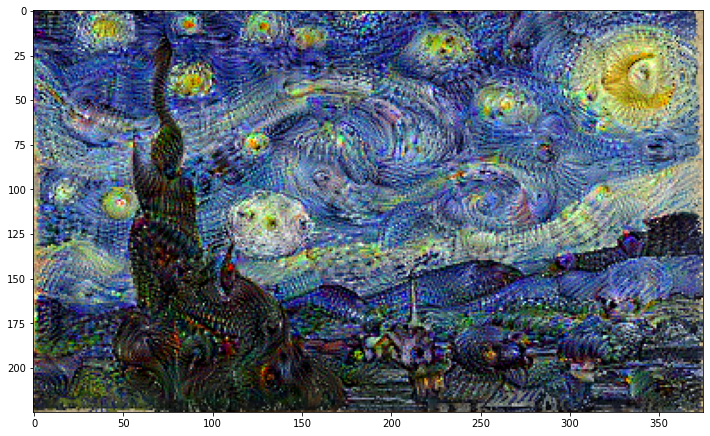

Epoch 6000, loss 2.3076024055480957


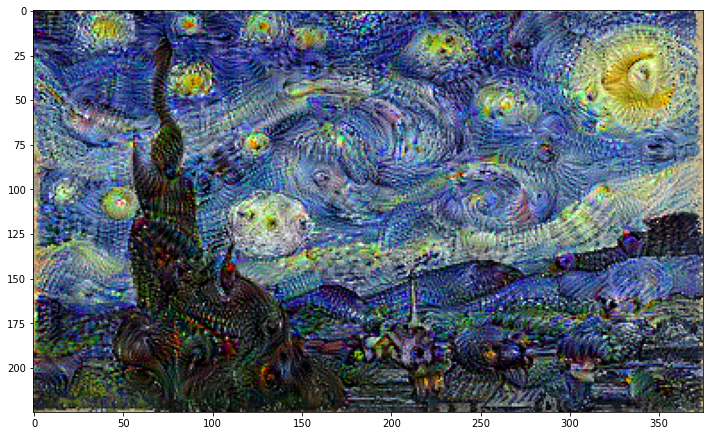

Epoch 6200, loss 2.3241095542907715


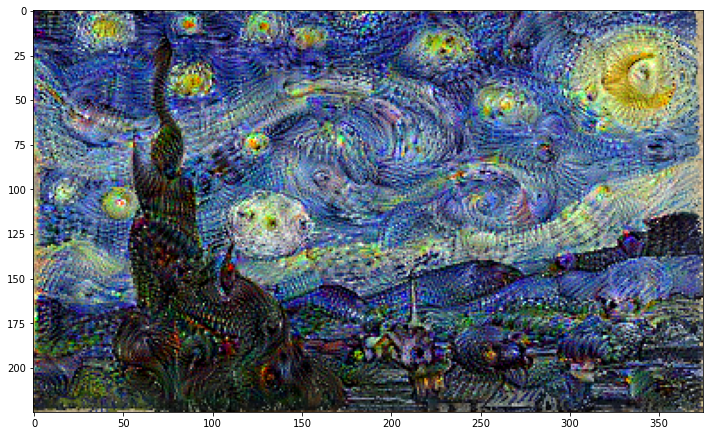

Epoch 6400, loss 2.3401923179626465


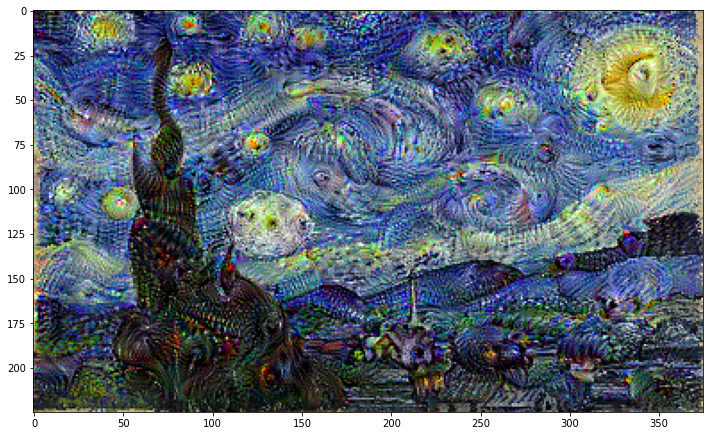

Epoch 6600, loss 2.3559484481811523


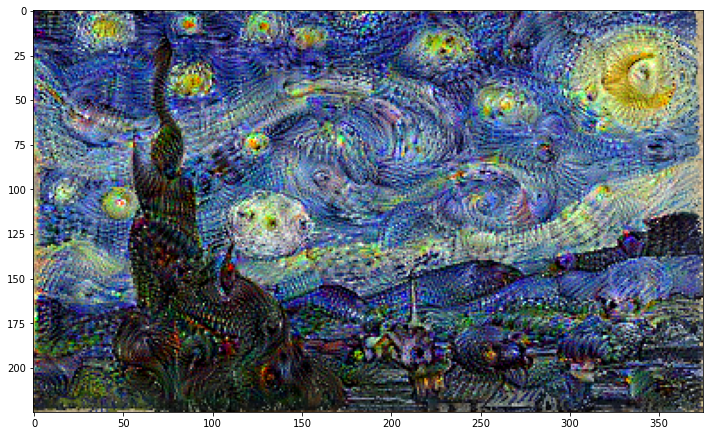

Epoch 6800, loss 2.3711161613464355


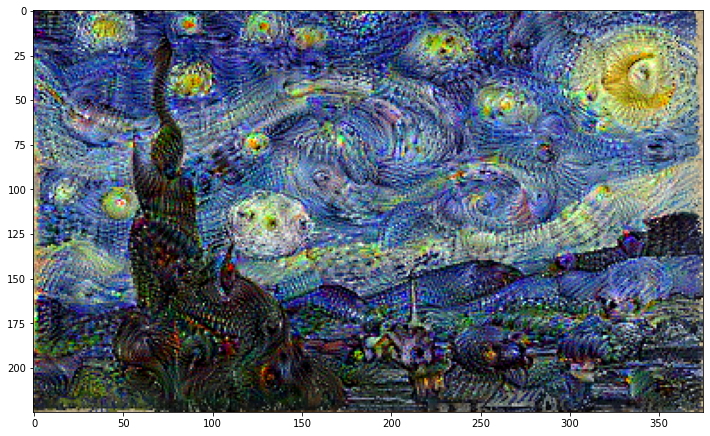

Epoch 7000, loss 2.3861477375030518


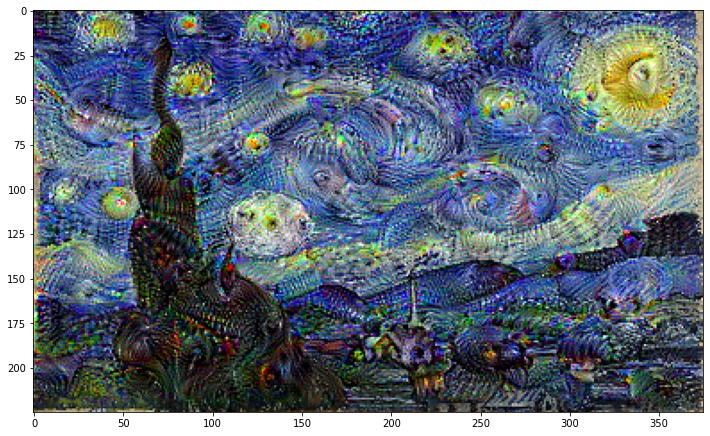

Epoch 7200, loss 2.4011974334716797


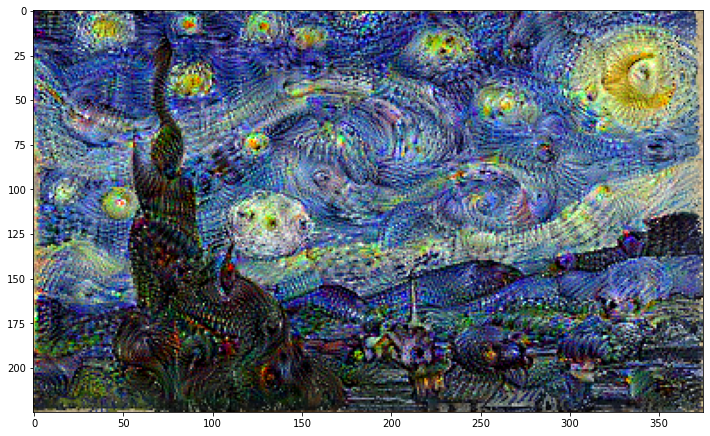

Epoch 7400, loss 2.415705919265747


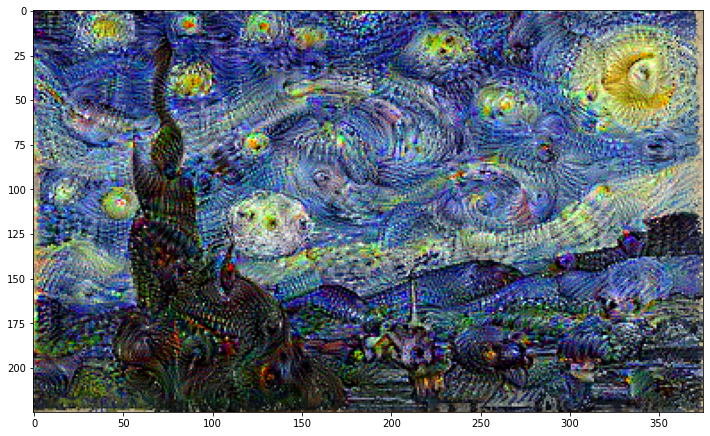

Epoch 7600, loss 2.4298362731933594


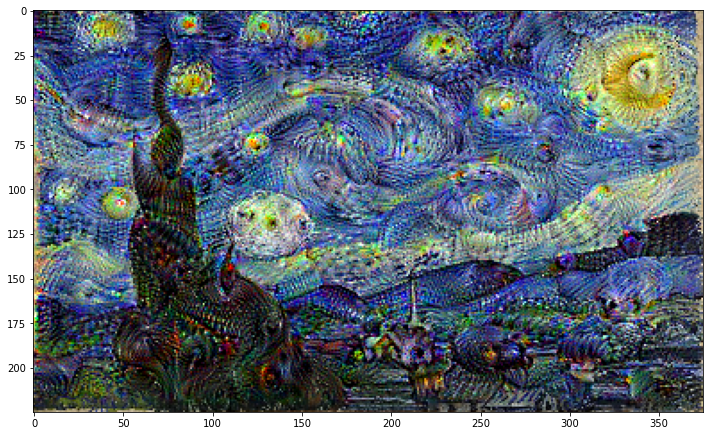

Epoch 7800, loss 2.4436841011047363


In [30]:
run_deep_dream(network=deep_dream_model, image=image, epochs = 8000, learning_rate=0.0001)